In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2
#import tensorflow as tf
import pathlib
import multiprocessing

In [ ]:
pip install keras-ocr

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
p = pathlib.Path('.')
[x for x in p.iterdir() if x.is_dir()]

[PosixPath('.config'), PosixPath('drive'), PosixPath('sample_data')]

In [ ]:
#training_paths = pathlib.Path('/content/drive/MyDrive/samples/train').glob('*.png')
test_paths = pathlib.Path('/content/drive/MyDrive/samples/test').glob('*.png')
validation_paths = pathlib.Path('/content/drive/MyDrive/samples/val').glob('*.png')

In [ ]:
training_paths = pathlib.Path('/content/drive/MyDrive/samples/train').glob('*.png')
training_paths_list = sorted([tp for tp in training_paths])

Training data is duplicated a few times due to IO issues`






In [ ]:
#training_paths_list = sorted([tp for tp in training_paths])
test_paths_list = sorted([tp for tp in test_paths])
validation_paths_list = sorted([vp for vp in validation_paths])

In [ ]:
print(len(test_paths_list), len(validation_paths_list))

6000 6000


In [ ]:
def load_covid_metadata(file_name):
    file = open(file_name,"r")
    data = file.read();
    covid_images = data.split("\n")
    return covid_images

def get_sorted_name_from_posix(posix_path_list, string_input = False):
  names_list = list(map(lambda dt: dt.name if not string_input else dt.split(' ')[0], posix_path_list))
  names_list.sort()
  return names_list

def get_labels(posix_path_list):
  names_list = list(map(lambda dt: dt.split(' ')[:2], posix_path_list))
  names_list.sort()
  return names_list

def get_duplicated_data():
  sorted_train_data_names = get_sorted_name_from_posix(training_paths_list)
  sorted_train_metadata_names = get_sorted_name_from_posix(metadata_train, string_input=True)
  sorted_train_meta = np.array(sorted_train_metadata_names)
  sorted_train_data = np.array(sorted_train_data_names)
  duplicated_data = []
  for i in range(0, len(sorted_train_data)):
   if(len(np.where(sorted_train_meta == sorted_train_data[i])[0]) == 0):
     duplicated_data.append(sorted_train_data[i])
  return duplicated_data


In [ ]:
metadata_test = load_covid_metadata('/content/drive/MyDrive/samples/sample_test_data.txt')
metadata_validation = load_covid_metadata('/content/drive/MyDrive/samples/sample_val_data.txt')
metadata_train = load_covid_metadata('/content/drive/MyDrive/samples/sample_train_data.txt')

In [ ]:
duplicated_data = get_duplicated_data()
cleaned_list = list(filter(lambda x: x.name not in duplicated_data, training_paths_list))
len(cleaned_list)

18000

In [ ]:
# Necessary preprocessing
# 1) check color space - convert to RGB - DONE
# 2) inpainting - DONE
# 3) convert to greyscale - DONE
# 4) exploration - check nine images, analyze histograms, plot - DONE
# 5) increase contrast
# 6) resize

In [ ]:
from concurrent.futures import ThreadPoolExecutor

def load_images_parallel(input_paths, labels, check_iter=[]):
  X = []
  y = []
  merged_list = []
  sorted_images = sorted(input_paths)
  metadata = get_labels(labels)

  for i in range(0, len(sorted_images)):
    if metadata[i][0] != sorted_images[i].name:
      raise Exception(f"Mismatched paths at index {i} {metadata[i][0]} and {sorted_images[i].name}")
    merged_list.append({"location": str(sorted_images[i]), "label": metadata[i][1], "name": sorted_images[i].name})

  with ThreadPoolExecutor(max_workers=4) as executor:
    for result in executor.map(task, merged_list):
      (image, label, name) = result
      X.append(image)
      y.append((label, name))
      if(len(X) in check_iter):
        print(f"Processed {len(X)} items")

  return (X,y)

In [ ]:
(X, y) = load_images_parallel(cleaned_list, metadata_train, [x for x in range(1000,18000,500)])

Processed 1000 items
Processed 1500 items
Processed 2000 items
Processed 2500 items
Processed 3000 items
Processed 3500 items
Processed 4000 items
Processed 4500 items
Processed 5000 items
Processed 5500 items
Processed 6000 items
Processed 6500 items
Processed 7000 items
Processed 7500 items
Processed 8000 items
Processed 8500 items
Processed 9000 items
Processed 9500 items
Processed 10000 items
Processed 10500 items
Processed 11000 items
Processed 11500 items
Processed 12000 items
Processed 12500 items
Processed 13000 items
Processed 13500 items
Processed 14000 items
Processed 14500 items
Processed 15000 items
Processed 15500 items
Processed 16000 items
Processed 16500 items
Processed 17000 items
Processed 17500 items


In [ ]:
len(set(map(lambda x: x[1], y)))

18000

In [ ]:
#check if there are color anomalies
def check_colour_distortion(input_data):
  outliers = []
  with ThreadPoolExecutor(max_workers=4) as executor:
   for result in executor.map(lambda sample: np.any(np.std(sample, axis=2) > 0.01), input_data):
    if result:
      outliers.append(sample)
  return outliers

from PIL import Image

def image_to_format(images, mode='RGB', disabled_print=True):
  X_new = []
  count = 0
  for image in images:
    pil_image = Image.fromarray(image)
    if mode != pil_image.mode:
      count = count + 1
      X_new.append(np.array(pil_image.convert(mode)))
    else:
      X_new.append(image)
  if not disabled_print:
    print(f'Converted {count} images to mode {mode}')
  return X_new

from skimage.restoration import inpaint_biharmonic
def inpaint_with_mask(image):
  return inpaint_biharmonic(image, np.where(np.std(image, axis=2) > 0.01, 1, 0), channel_axis=2)

def plot_images(images, title='', color_map='viridis', value_min=None, value_max=None):
  fig, axs = plt.subplots(1,len(images), figsize=(50,48))
  fig.suptitle(title)
  if len(images) == 1:
    axs.imshow(images[0], cmap=color_map, vmin=value_min, vmax=value_max)
    return
  for i in range(0, len(images)):
    axs[i].imshow(images[i], cmap=color_map, vmin=value_min, vmax=value_max)
#plot_images([temp2, temp1], 'Image before and after added marking')

In [ ]:
sample = X[0]
temp_arr = np.array(X[0:10])
#outliers = check_colour_distortion(X)
temp1 = np.copy(X[0])
temp2 = np.copy(X[0])

for i in range(180,205):
  for j in range(180, 205):
   temp1[i][j] = [238, 75, 43]

np.any(np.std(temp1, axis=2) > 0.01)

True

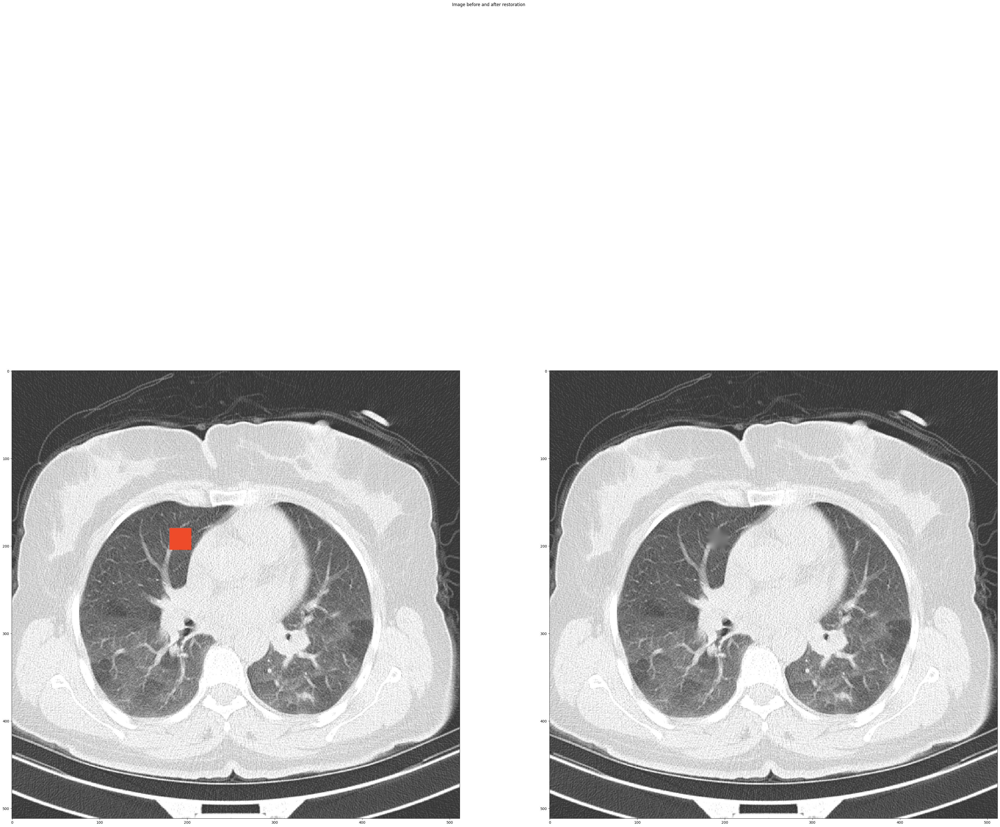

In [ ]:
plot_images([temp1, inpaint_with_mask(temp1)], 'Image before and after restoration')

In [ ]:
X_greyscale = image_to_format(X, mode='L')

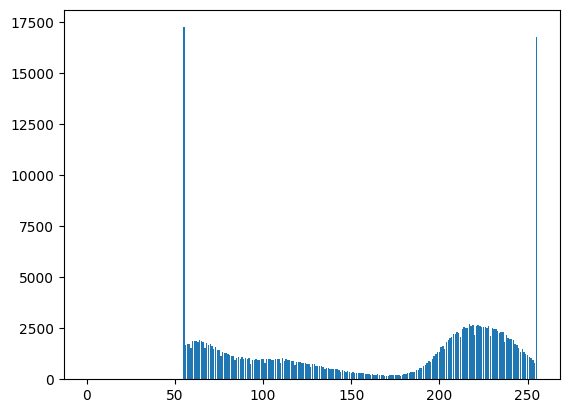

In [ ]:
histogram = cv2.calcHist([X_greyscale[0]], [0], None, histSize=[256], ranges=[], accumulate=False)
indices = np.arange(len(histogram))
plt.bar(indices, np.reshape(histogram, (256,)))
plt.show()

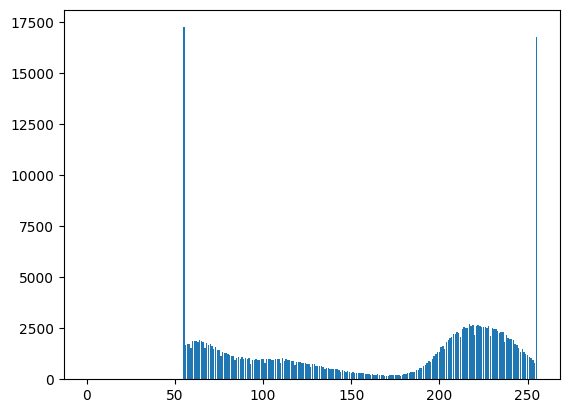

In [ ]:
indices = np.arange(len(histogram))
plt.bar(indices,np.reshape(histogram, (256,)))
plt.show()

In [ ]:
def calc_hist(images):
  histogram_deviations = []
  for image in images:
    histogram = cv2.calcHist([image], [0], None, histSize=[256], ranges=[], accumulate=False)
    histogram_deviations.append((histogram, np.std(histogram), image))
  return sorted(histogram_deviations, key=lambda x: x[1])

In [ ]:
histograms = calc_hist(X_greyscale)

In [ ]:
def normalize_data(data, should_normalize=True):
  if should_normalize:
    return data/np.sum(data);
  return data

def visualize_histograms(histograms, hist_indeces, dims=(1,1), normalize=False):
  rows, cols = dims
  fig, axs = plt.subplots(rows, cols, gridspec_kw={'wspace': 0.5}, sharey=normalize)
  fig.suptitle('Ordered by standard deviation in ascending order')
  indices = np.arange(256)
  h_ind = 0
  for i in range(rows):
    for j in range(cols):
      if rows != 1 or cols != 1:
        axs[i][j].bar(indices,np.reshape(normalize_data(histograms[hist_indeces[h_ind]][0], normalize), (256,)))
      else:
        axs.bar(indices,np.reshape(normalize_data(histograms[hist_indeces[h_ind]][0], normalize), (256,)))
      h_ind = h_ind + 1

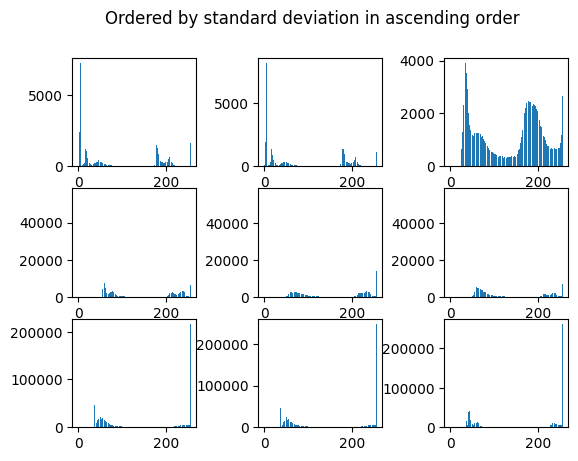

In [ ]:
visualize_histograms(histograms, [0,1,2, int(len(histograms)/2 - 1), int(len(histograms)/2), int(len(histograms)/2 + 1), int(len(histograms)-3), int(len(histograms)-2), int(len(histograms)-1)], dims=(3,3))

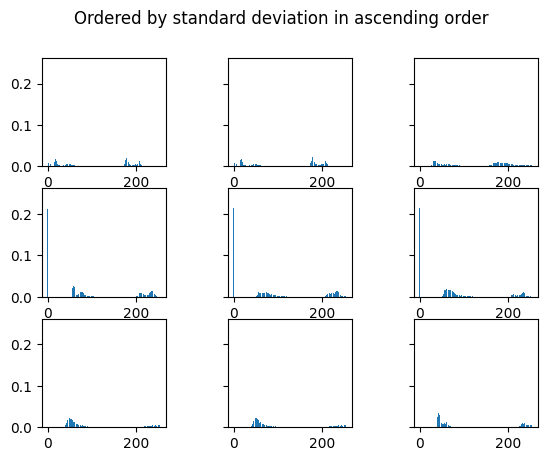

In [ ]:
visualize_histograms(histograms, [0,1,2, int(len(histograms)/2 - 1), int(len(histograms)/2), int(len(histograms)/2 + 1), int(len(histograms)-3), int(len(histograms)-2), int(len(histograms)-1)], dims=(3,3), normalize=True)

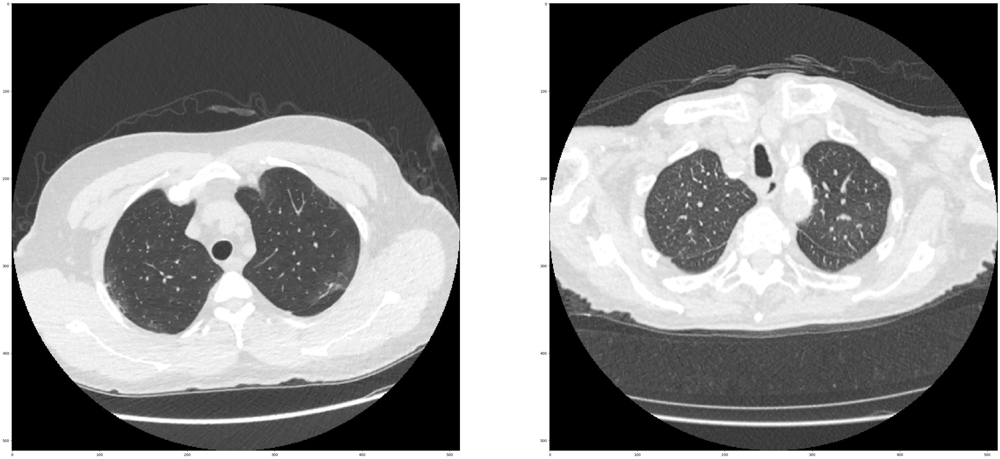

In [ ]:
plot_images([histograms[int(len(histograms)/2 - 1)][2],  histograms[int(len(histograms)/2)][2]], color_map='gray',  value_min=0, value_max=255)

/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: This might be a color image. The histogram will be computed on the flattened image. You can instead apply this function to each color channel, or set channel_axis.
  return func(*args, **kwargs)


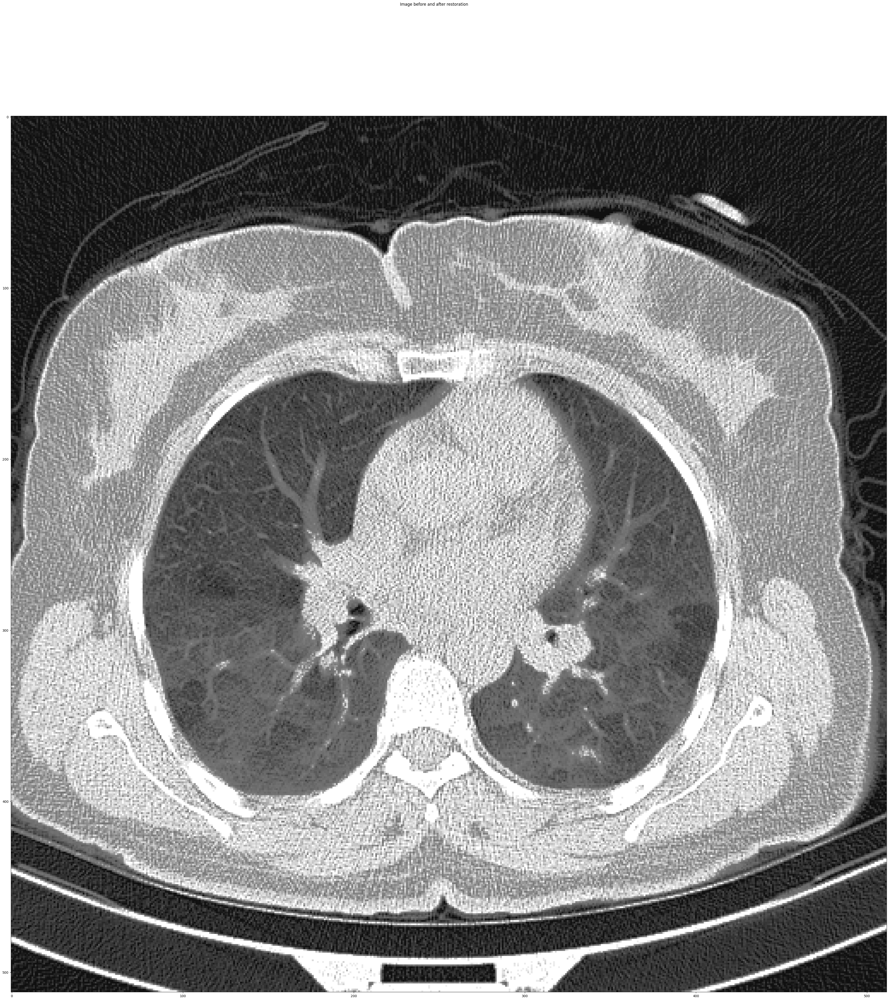

In [ ]:
from skimage.exposure import equalize_adapthist
from skimage.exposure import equalize_hist
plot_images([equalize_hist(X[0])], 'Image before and after restoration', color_map='gray',  value_min=0, value_max=255)

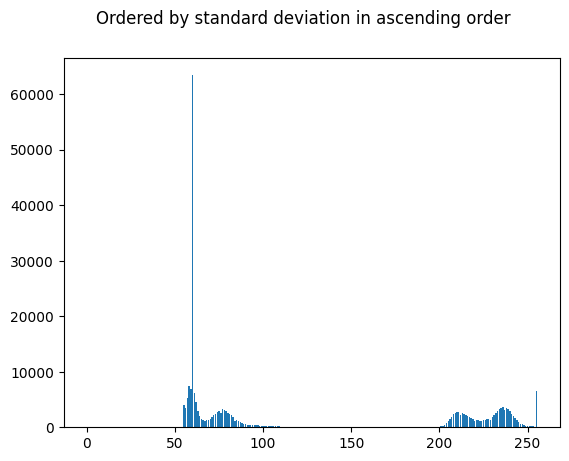

In [ ]:
visualize_histograms([calc_hist([x])[0]], hist_indeces=[0])

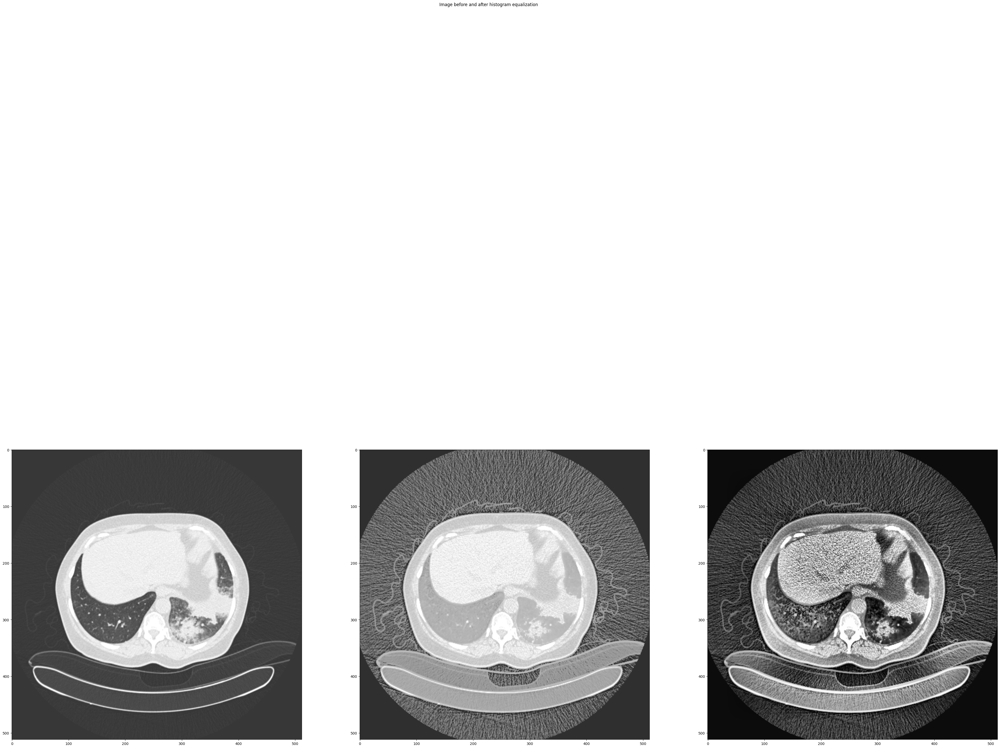

In [ ]:
plot_images([X[500], equalize_hist(X[500]), equalize_adapthist(X[500], clip_limit=1/20)], 'Image before and after histogram equalization')

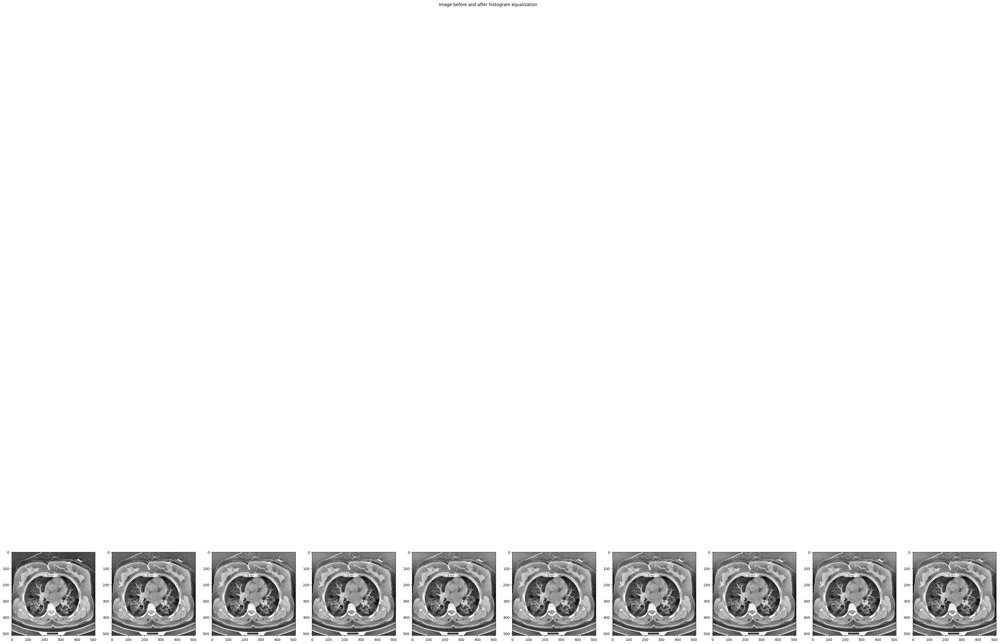

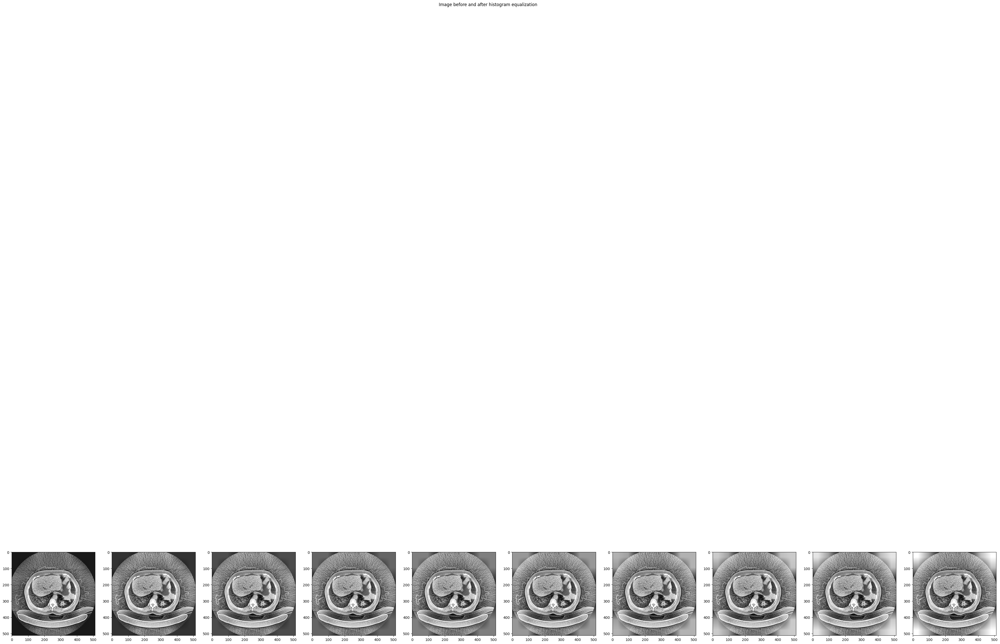

In [ ]:
plot_images([equalize_adapthist(X[0], clip_limit=x/10) for x in range(1,11)], 'Image before and after histogram equalization')
plot_images([equalize_adapthist(X[500], clip_limit=x/10) for x in range(1,11)], 'Image before and after histogram equalization')

In [ ]:
# 1) Write a working Neural Network with two layers
# 2) Write a genetic algorithm for Convolutions and Test for five epochs
# 3) Write a genetic algorithm for Fully Connected Layers and Test for five epochs
# 4) Write a genetic algorithm for ADAM and Test for five epochs
# 5) Run for a population=100, generations=100 for 100 layer additions conv and 25 layer additions fully connected
# 6) On every block end freeze weights, copy model and train in parallel with random search
# 7) In the end, execute ResNet, VGG and Inception for the same period of epochs

In [ ]:
shapes = set()
for image in X:
  shapes.add(image.shape)

In [ ]:
shape_list = []
for shape in shapes:
  shape_list.append(f'{shape[0]} {shape[1]} {shape[2]}')

In [ ]:
shape_dict = {}
for shape in shape_list:
  shape_dict[shape] = 0

In [ ]:
for image in X:
   shape_dict[f'{image.shape[0]} {image.shape[1]} {image.shape[2]}'] = shape_dict[f'{image.shape[0]} {image.shape[1]} {image.shape[2]}'] + 1

In [ ]:
len(X)

18000

In [ ]:
shape_dict

{'428 630 3': 15,
 '525 630 3': 7,
 '623 630 3': 11,
 '630 595 3': 1,
 '629 629 3': 37,
 '630 619 3': 2,
 '630 617 3': 2,
 '630 608 3': 1,
 '630 630 3': 300,
 '630 533 3': 1,
 '768 768 3': 1,
 '330 630 3': 1,
 '489 630 3': 12,
 '512 512 3': 17567,
 '429 630 3': 1,
 '1024 1024 3': 27,
 '401 630 3': 1,
 '627 630 3': 1,
 '256 256 3': 2,
 '566 630 3': 2,
 '630 627 3': 5,
 '538 630 3': 1,
 '630 618 3': 2}

In [ ]:
differing_ratios = []
for image in X:
  if image.shape[0] != image.shape[1]:
    differing_ratios.append(image)

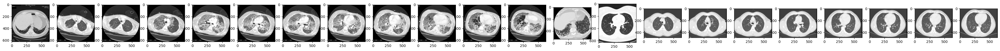

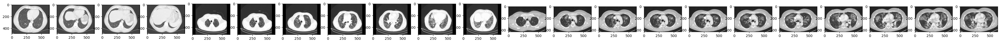

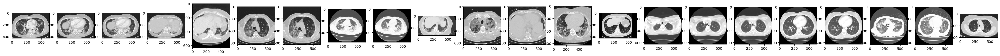

In [ ]:
plot_images(differing_ratios[:22])
plot_images(differing_ratios[22:44])
plot_images(differing_ratios[44:66])

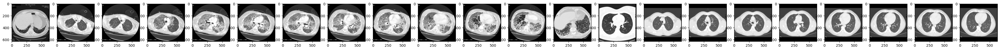

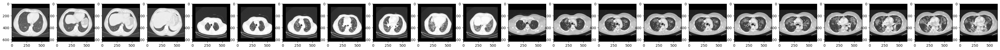

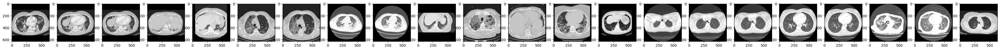

In [ ]:
padded_images = transform_differing_ratios(differing_ratios)
plot_images(padded_images[:22])
plot_images(padded_images[22:44])
plot_images(padded_images[44:66])

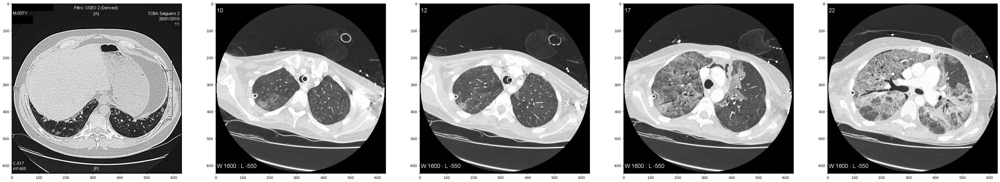

In [ ]:
plot_images(padded_images[:5])

In [ ]:
#dirty_images = image_to_format(padded_images[:5], mode='L')
padded_images[0].shape

(630, 630, 3)

In [ ]:
x_0 = equalize_adapthist(padded_images[2], clip_limit=0.1)
rescaled_image = (x_0 * 255).astype(np.uint8)
#Image.fromarray(np.array(rescaled_image))

In [ ]:
import copy

def transform_differing_ratios(images):
  transformed_images = []
  for image in images:
    pil_image = Image.fromarray(image)
    width, height = pil_image.size

    if width == height:
      transformed_images.append(image)
      continue

    new_height = height
    new_width = width

    if height > width:
      new_width = height
    elif height < width:
      new_height = width

    result = Image.new(pil_image.mode, (new_width, new_height), 0)

    if height > width:
      result.paste(pil_image, (int((height - width)/2), 0))
    elif height < width:
      result.paste(pil_image, (0, int((width - height)/2)))
    transformed_images.append(np.array(result))
  return transformed_images

def resize_images(images, target_resolution=(512, 512), interpolation_method=cv2.INTER_CUBIC):
  X_resized = []
  for image in images:
    X_resized.append(cv2.resize(image, target_resolution, interpolation=interpolation_method))
  return X_resized

import math
from skimage.filters import threshold_otsu
from dataclasses import dataclass
from typing import Tuple

@dataclass
class OcrBlock:
    dtype: str
    shape: Tuple[int]
    bytearr: bytes

# Code blocks for thickness and midpoint calculation
# using Keras OCR are taken from Carlo Borella's blog
# “Remove Text from Images using CV2 and Keras-OCR”
# available at https://towardsdatascience.com/remove-text-from-images-using-cv2-and-keras-ocr
# and adapted here to serve my particular use case.
# Proper citation of his work is available in the full thesis's text

def midpoint(x1, y1, x2, y2):
    x_mid = int((x1 + x2)/2)
    y_mid = int((y1 + y2)/2)
    return (x_mid, y_mid)

def get_binarized_image(input_image):
  grayscale = image_to_format([input_image], 'L')[0]
  threshold = threshold_otsu(grayscale)
  mask = grayscale > threshold
  return image_to_format([mask], 'RGB')[0]
#plot_images(image_to_format([rescaled_image, get_binarized_image(rescaled_image)], 'RGB'))


def check_background(box_coordinates, image, disabled_print=True):
  xmin, ymin = np.min(box_coordinates, axis=0)
  xmax, ymax = np.max(box_coordinates, axis=0)
  if xmax < 0:
    xmax = 0
  if ymin < 0:
    ymin = 0
  if xmin < 0:
    xmin = 0
  if ymax < 0:
    ymax = 0
  region_pixels = image[int(ymin):int(ymax), int(xmin):int(xmax), :]

  new_region = get_binarized_image(region_pixels)
  boundaries = np.concatenate((new_region[:,new_region.shape[1]-1],
                            new_region[:,0],
                            new_region[0,:],
                            new_region[new_region.shape[0]-1,:]))
  if not np.all(boundaries == 0) and not disabled_print:
    print(f'PERCENTAGE: {np.sum(boundaries/255)/(boundaries.shape[0]*boundaries.shape[1])}')
  return np.all(boundaries == 0) or np.sum(boundaries/255)/(boundaries.shape[0]*boundaries.shape[1]) < 0.05

def inpaint_images(images,result_queue=None):
    import keras_ocr
    pipeline = keras_ocr.pipeline.Pipeline()
    prediction_groups = pipeline.recognize(images)
    mask = np.zeros(images[0].shape[:2], dtype="uint8")
    count = 0
    #np.save('array_list.npy', images)
    for prediction_group in prediction_groups:
      img = None
      #print('Exec')
      for box in prediction_group:
          x0, y0 = box[1][0]
          x1, y1 = box[1][1]
          x2, y2 = box[1][2]
          x3, y3 = box[1][3]

          if check_background(box[1], images[count]):
            x_mid0, y_mid0 = midpoint(x1, y1, x2, y2)
            x_mid1, y_mi1 = midpoint(x0, y0, x3, y3)

            thickness = int(math.sqrt((x2 - x1)**2 + (y2 - y1)**2 ))
            cv2.line(mask, (x_mid0, y_mid0), (x_mid1, y_mi1), 255, thickness)
            img = cv2.inpaint(images[count], mask, 7, cv2.INPAINT_NS)
      images[count] = img if img is not None else images[count]
      img = None
      count = count + 1
    print(f'LEN images {len(images)}')
    np.save('array_list.npy', images)
    print('FINISHED')
    return []

In [ ]:
from skimage.exposure import equalize_adapthist

def check_colour_distortion_preprocessed(input_data):
  outliers = []
  with ThreadPoolExecutor(max_workers=4) as executor:
   for result in executor.map(lambda sample: np.any(np.std(sample[0], axis=2) > 0.01), input_data):
    if result:
      outliers.append(sample)
  return outliers

import os
def save_to_directory(image):
  pil_image = Image.fromarray(image[0])
  pil_image = pil_image.convert("L")
  pil_image = pil_image.convert("RGB")
  if image[1][0] == '0':
    os.makedirs('/content/covid_ct/class_normal/', exist_ok=True)
    pil_image.save(f'/content/covid_ct/class_normal/{image[1][1]}', 'PNG')
  elif image[1][0] == '1':
    os.makedirs('/content/covid_ct/class_pneumonia/', exist_ok=True)
    pil_image.save(f'/content/covid_ct/class_pneumonia/{image[1][1]}', 'PNG')
  elif image[1][0] == '2':
    os.makedirs('/content/covid_ct/class_covid/', exist_ok=True)
    pil_image.save(f'/content/covid_ct/class_covid/{image[1][1]}', 'PNG')

def save_to_directory_val(image):
  pil_image = Image.fromarray(image[0])
  pil_image = pil_image.convert("L")
  pil_image = pil_image.convert("RGB")
  if image[1][0] == '0':
    os.makedirs('/content/covid_ct_val/class_normal/', exist_ok=True)
    pil_image.save(f'/content/covid_ct_val/class_normal/{image[1][1]}', 'PNG')
  elif image[1][0] == '1':
    os.makedirs('/content/covid_ct_val/class_pneumonia/', exist_ok=True)
    pil_image.save(f'/content/covid_ct_val/class_pneumonia/{image[1][1]}', 'PNG')
  elif image[1][0] == '2':
    os.makedirs('/content/covid_ct_val/class_covid/', exist_ok=True)
    pil_image.save(f'/content/covid_ct_val/class_covid/{image[1][1]}', 'PNG')

def save_to_directory_test(image):
  pil_image = Image.fromarray(image[0])
  pil_image = pil_image.convert("L")
  pil_image = pil_image.convert("RGB")
  if image[1][0] == '0':
    os.makedirs('/content/covid_ct_test/class_normal/', exist_ok=True)
    pil_image.save(f'/content/covid_ct_test/class_normal/{image[1][1]}', 'PNG')
  elif image[1][0] == '1':
    os.makedirs('/content/covid_ct_test/class_pneumonia/', exist_ok=True)
    pil_image.save(f'/content/covid_ct_test/class_pneumonia/{image[1][1]}', 'PNG')
  elif image[1][0] == '2':
    os.makedirs('/content/covid_ct_test/class_covid/', exist_ok=True)
    pil_image.save(f'/content/covid_ct_test/class_covid/{image[1][1]}', 'PNG')


import multiprocessing

def preprocess_dataset(X_input, y_labels):
  # [0]: image [1]: (filename, label) [2] index
  for label_index, label_tuple in enumerate(y_labels):
    X_input[label_index] = (X_input[label_index], label_tuple, label_index)

  # Inpaint color distortions
  outliers = check_colour_distortion_preprocessed(X_input)
  for outlier in outliers:
    X_input[outlier[2]][0] = inpaint_with_mask(outlier[0])

  print('INPAINTED DISTORTIONS')

  for x_index, x_image in enumerate(X):
    X[x_index] = x_image[0]

  # Add padding
  X_input = transform_differing_ratios(X_input)

  print('ADDED PADDING')
  X_input = resize_images(X_input, target_resolution=(512,512))

  print('RESIZED')

  # Inpaint text
  X_input_new = []
  old_step = 0
  for new_step in range(10, len(X_input) + 1, 10):
    process_eval = multiprocessing.Process(target=inpaint_images, args=(X_input[old_step:new_step], None))
    process_eval.start()
    process_eval.join()
    loaded_array_list = np.load('array_list.npy', allow_pickle=True)
    print(len(loaded_array_list))
    X_input_new.extend(loaded_array_list)
    old_step = new_step
  print('Inpainted text')
  X_input = X_input_new
  X_input = resize_images(X_input, target_resolution=(224,224))

  for label_index, label_tuple in enumerate(y_labels):
    X_input[label_index] = (X_input[label_index], label_tuple, label_index)

  return X_input


In [ ]:
# (X_test, y_test) = load_images_parallel(test_paths_list, metadata_test, [x for x in range(1000,6000,500)])
# (X_val, y_val) = load_images_parallel(validation_paths_list, metadata_validation, [x for x in range(1000,6000,500)])
# X_new_test = preprocess_dataset(X_test, y_test)
# X_new_val = preprocess_dataset(X_val, y_val)

# for x_new_image in X_new_test:
#   save_to_directory_test(x_new_image)
# !zip -r /content/covid_ct_test.zip /content/covid_ct_test

# for x_new_image in X_new_val:
#   save_to_directory_val(x_new_image)
# !zip -r /content/covid_ct_val.zip /content/covid_ct_val

from google.colab import files
files.download("/content/covid_ct_val.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
import shutil
shutil.rmtree('/content/content', ignore_errors=True)
shutil.rmtree('/content/content', ignore_errors=True)


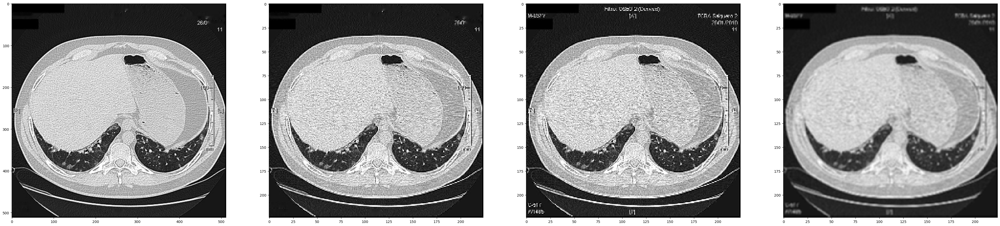

In [ ]:
new_arr = resize_images([X_new[0][0]], target_resolution=(224,224))
new_arr_1 = resize_images([padded_images[0]], target_resolution=(224,224))
denoised_gaussian_05 = cv2.GaussianBlur(new_arr_1[0],(3,3), 1)
plot_images([X_new[0][0], *new_arr, *new_arr_1, denoised_gaussian_05], color_map='gray',  value_min=0, value_max=255)
# for x_new_image in X_new:
#   print('Process')(rgb_equalized_image * 255).astype('uint8')
#   x_new_image[0]*255
#   Image.fromarray()
#   #save_to_directory(x_new_image)

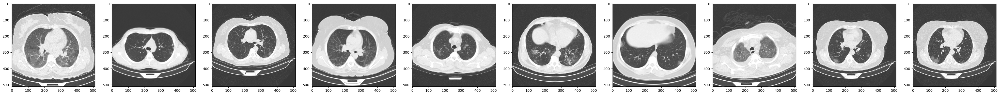

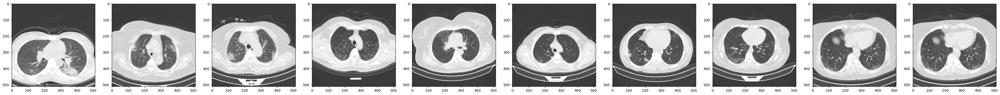

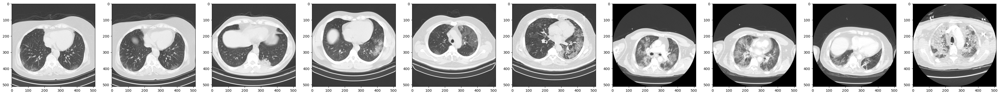

In [ ]:
plot_images([x for x in X[:10]], color_map='gray',  value_min=0, value_max=255)
plot_images([x for x in X[10:20]], color_map='gray',  value_min=0, value_max=255)
plot_images([x for x in X[20:30]], color_map='gray',  value_min=0, value_max=255)

In [ ]:
np.save('array_list.npy', allow_pickle=True)

Once deleted, variables cannot be recovered. Proceed (y/[n])? y


In [ ]:
arr = np.empty((630, 630), dtype=object)
for i in range(630):
  for j in range(630):
    arr[i][j] = (i,630-j)

box_coordinates = np.array([[230., 9.], [269., 9.], [269., 24.], [230., 24.]])
xmin, ymin = np.min(box_coordinates, axis=0)
xmax, ymax = np.max(box_coordinates, axis=0)
region_pixels = padded_images[0][int(ymin):int(ymax), int(xmin):int(xmax), :]


In [ ]:
np.zeros((512,512)).shape

(512, 512)

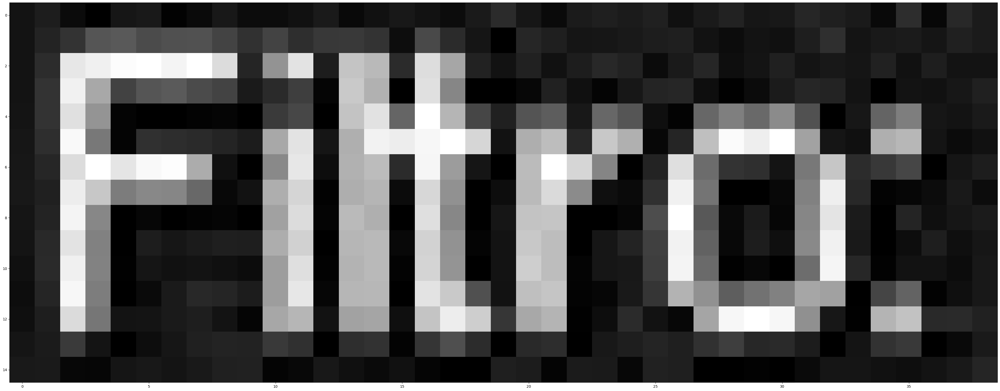

In [ ]:
plot_images([region_pixels])

In [ ]:
l = [region_pixels[0][:].shape, region_pixels[:][0].shape]
region_pixels[:,region_pixels.shape[1]-1]
region_pixels[:,0]
region_pixels[0,:]
region_pixels[region_pixels.shape[0]-1,:]
np.all(region_pixels[region_pixels.shape[0]-1,:] == 0)

False

In [ ]:
grayscale = image_to_format([rescaled_image], 'L')[0]

In [ ]:
l = [region_pixels[0][:].shape, region_pixels[:][0].shape]
region_pixels[:,region_pixels.shape[1]-1]
region_pixels[:,0]
region_pixels[0,:]
region_pixels[region_pixels.shape[0]-1,:]
np.all(region_pixels[region_pixels.shape[0]-1,:] == 0)

False

In [ ]:
from dataclasses import dataclass
from typing import List, Tuple
import multiprocessing
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import pathlib

@dataclass
class ConvBlock:
    metadata: dict
    shape: tuple

@dataclass
class ConvGroup:
    blocks: List[ConvBlock]
    residual_conn: bool

@dataclass
class ConnectedBlock:
    metadata: dict

@dataclass
class ConnectedGroup:
    blocks: List[ConnectedBlock]
    residual_conn: bool

@dataclass
class Chromosome:
    fitness: str
    structure: List[ConvGroup | ConnectedGroup]
    implementation: object

@dataclass
class Settings:
  population_size: int
  mutation: float
  elite: float
  generations: int
  conv_blocks_proportion: float
  blocks: int
  elite_max: int
  input_size: Tuple[int]
  layers_init: int
  epochs: int
  validation_set_path: str
  train_set_path: str


@dataclass
class Results:
    mutation_list: List[float]
    elite_list: List[float]
    fitness_list: List[float]

@dataclass
class Metadata:
    layer_count: int
    meta_gen: int
    last_gen: bool
    last_chrom: bool
    conv_block_curr: float
    epochs: int
    validation_set_path: str
    train_set_path: str

@dataclass
class FitnessData:
    best_fit: float
def sigmoid(x):
  return 1/(1+np.exp(-x))

def get_value_by_key(key, residual_conn, conv_block_curr=0):
  kernel = [1,3,5,7]
  stride = [1,2]
  batch_norm = [True, False]
  activation = ['tanh', 'relu']
  padding = ['same', 'valid']
  pooling = [False, False]
  pool_stride=[1,2]
  pooling_type = ['avg', 'max']
  pooling_pad = ['same', 'valid']

  if residual_conn and key == 'pooling':
     return False

  if residual_conn and key == 'padding':
     return 'same'

  if residual_conn and key == 'kernel':
     return 3

  if conv_block_curr >= 0.5:
    filter = [128, 256, 512]
  else:
    filter = [32, 64, 96]

  match key:
            case 'kernel': return kernel[np.random.randint(0, len(kernel))]
            case 'stride': return stride[np.random.choice([i for i in range(len(stride))], p=[0.9,0.1])]
            case 'batch_norm': return batch_norm[np.random.randint(0, len(batch_norm))]
            case 'activation': return activation[np.random.randint(0, len(activation))]
            case 'padding': return padding[np.random.randint(0, len(padding))]
            case 'filter': return filter[np.random.randint(0, len(filter))]
            case 'pooling': return pooling[np.random.choice([i for i in range(len(pooling))], p=[0.2,0.8])]
            case 'pool_stride': return pool_stride[np.random.choice([i for i in range(len(pool_stride))], p=[0.5,0.5])]
            case 'pooling_type': return pooling_type[np.random.randint(0, len(pooling_type))]
            case 'pooling_pad': return pooling_pad[np.random.randint(0, len(pooling_pad))]

def get_value_by_key_conn(key):
  layer_size = [32, 64, 128, 256]
  dropout_coef = [0.1,0.2,0.3]
  dropout=[True, False]
  activation = ['tanh', 'relu']

  match key:
            case 'layer_size': return layer_size[np.random.randint(0, len(layer_size))]
            case 'dropout_coef': return dropout_coef[np.random.randint(0, len(dropout_coef))]
            case 'dropout': return dropout[np.random.randint(0, len(dropout))]
            case 'activation': return activation[np.random.randint(0, len(activation))]

def generate_conv_filter(conv_block_curr=0):
  kernel = [1,3,5,7]
  stride = [1, 2]
  batch_norm = [True, False]
  activation = ['tanh', 'relu']
  padding = ['same', 'valid']
  pooling = [True, False]
  pool_stride=[1, 2]
  pooling_type = ['avg', 'max']
  pooling_pad = ['same', 'valid']
  if conv_block_curr >= 0.5:
    filter = [128, 256, 512]
  else:
    filter = [32, 64, 96]

  stride_val = stride[np.random.choice([i for i in range(len(stride))], p=[0.9,0.1])]
  if stride_val == 2:
    pooling_val =  False
  else:
    pooling_val = pooling[np.random.choice([i for i in range(len(pooling))], p=[0.2,0.8])]
  return {
      'kernel': kernel[np.random.randint(0, len(kernel))],
      'stride': stride_val,
      'batch_norm': batch_norm[np.random.randint(0, len(batch_norm))],
      'activation': activation[np.random.randint(0, len(activation))],
      'padding': padding[np.random.randint(0, len(padding))],
      'filter': filter[np.random.randint(0, len(filter))],
      'pooling': pooling_val,
      'pool_stride': pool_stride[np.random.choice([i for i in range(len(pool_stride))], p=[0.5,0.5])],
      'pooling_type': pooling_type[np.random.randint(0, len(pooling_type))],
      'pooling_pad': pooling_pad[np.random.randint(0, len(pooling_pad))]
  }

def generate_dense_layer():
  layer_size = [32, 64, 128, 256]
  dropout_coef = [0.1,0.2,0.3]
  dropout=[False, False]
  activation = ['tanh', 'relu']

  return {
      'layer_size': layer_size[np.random.randint(0, len(layer_size))],
      'dropout_coef': dropout_coef[np.random.randint(0, len(dropout_coef))],
      'dropout': dropout[np.random.randint(0, len(dropout))],
      'activation': activation[np.random.randint(0, len(activation))],
  }

def critical_section(result_queue, chromosome, base, best_fit_rec: Metadata, best_fit):
    import tensorflow as tf
    from tensorflow.keras.layers import Dropout, Add, Input, Conv2D, Flatten, Dense, Activation, BatchNormalization, MaxPooling2D, AvgPool2D
    from tensorflow.keras import Model
    from tensorflow.keras.saving import save_model
    from tensorflow.keras.models import load_model
    from tensorflow.keras.utils import to_categorical

    config = tf.compat.v1.ConfigProto()
    config.gpu_options.allow_growth = True
    sess = tf.compat.v1.Session(config=config)

    dataset = tf.keras.utils.image_dataset_from_directory(best_fit_rec.train_set_path, color_mode='grayscale', image_size=(224,224), label_mode='categorical')
    validation_dataset = tf.keras.utils.image_dataset_from_directory(best_fit_rec.validation_set_path, color_mode='grayscale', image_size=(224,224), label_mode='categorical')

    def build_conv_block(metadata, input):
      result = Conv2D(metadata['filter'], (metadata['kernel'], metadata['kernel']),name=f"conv_layer_{best_fit_rec.layer_count}", strides=(metadata['stride'], metadata['stride']), padding=metadata['padding'])(input)
      best_fit_rec.layer_count = best_fit_rec.layer_count + 1
      if metadata['batch_norm']:
        result = BatchNormalization(name=f"batch_norm_{best_fit_rec.layer_count}")(result)
      result = Activation(metadata['activation'], name=f"activation_{best_fit_rec.layer_count}")(result)
      if metadata['pooling'] and metadata['pooling_type'] == 'max':
        result = MaxPooling2D(pool_size=(2, 2), name=f"max_pool_layer_{best_fit_rec.layer_count}", strides=(metadata['pool_stride'], metadata['pool_stride']), padding=metadata['pooling_pad'])(result)
        best_fit_rec.layer_count = best_fit_rec.layer_count + 1
      elif metadata['pooling'] and metadata['pooling_type'] == 'avg':
        result = AvgPool2D(pool_size=(2, 2), name=f"avg_pool_layer_{best_fit_rec.layer_count}", strides=(metadata['pool_stride'], metadata['pool_stride']), padding=metadata['pooling_pad'])(result)
        best_fit_rec.layer_count = best_fit_rec.layer_count + 1
      return result

    def build_connection_block(metadata, input):
      result = Dense(metadata['layer_size'],name=f"dense_layer_{best_fit_rec.layer_count}", activation=metadata['activation'])(input)
      best_fit_rec.layer_count = best_fit_rec.layer_count + 1
      if metadata['dropout']:
        result = Dropout(metadata['dropout_coef'], name=f"dropout_{best_fit_rec.layer_count}")(result)
        best_fit_rec.layer_count = best_fit_rec.layer_count + 1
      return result


    def add_layer(group, group_index, conv_layer_count, is_flattened, input, result, is_first_dense):
     if isinstance(group, ConvGroup):
       if group.residual_conn:
        for block in group.blocks:
          block.metadata['pooling'] = False
          if block.metadata['kernel'] > 3:
             block.metadata['kernel'] = 3
          block.metadata['padding'] = 'same'
          block.metadata['stride'] = 1
      #  for block in group.blocks:
      #     block.metadata['batch_norm'] = False

       if group_index == 0:
          shortcut = Conv2D(group.blocks[1].metadata['filter'], (1, 1),name=f'conv_shortcut_{best_fit_rec.layer_count}', strides=(1,1))(input) if group.residual_conn else None
          result = build_conv_block(group.blocks[0].metadata, input)
       else:
          shortcut = Conv2D(group.blocks[1].metadata['filter'], (1, 1),name=f'conv_shortcut_{best_fit_rec.layer_count}', strides=(1,1))(result) if group.residual_conn else None
          result = build_conv_block(group.blocks[0].metadata, result)
       result = build_conv_block(group.blocks[1].metadata, result)

       if group.residual_conn:
          result = Add(name=f'shortcut_add_{best_fit_rec.layer_count}')([result, shortcut])
          best_fit_rec.layer_count = best_fit_rec.layer_count + 1

       if result.shape[2] > 100:
          result = AvgPool2D(pool_size=(2, 2), name=f"avg_pool_layer_second_normalizing_{best_fit_rec.layer_count}", padding='valid')(result)
       if result.shape[3] > 128:
          result = Conv2D(128, (1, 1),name=f'conv_identity_2{best_fit_rec.layer_count}', activation='relu', strides=(1,1))(result)

     elif isinstance(group, ConnectedGroup):
      if conv_layer_count == 0 and group_index == 0:
        result = Flatten(name=f'flatten{best_fit_rec.layer_count}')(input)
        best_fit_rec.layer_count = best_fit_rec.layer_count + 1
        is_flattened = True
      elif group_index == conv_layer_count:
        result = Flatten(name=f'flatten{best_fit_rec.layer_count}')(result)
        best_fit_rec.layer_count = best_fit_rec.layer_count + 1
        is_flattened = True
      result = build_connection_block(group.blocks[0].metadata, result)
      result = build_connection_block(group.blocks[1].metadata, result)
     return (result, is_flattened)

    def add_layer_over_base(group, group_index, conv_layer_count, is_flattened, base_model_output, result, is_first_dense):
     for layer in base_model_output.layers:
        if isinstance(layer, Flatten):
          is_first_dense = False
          is_flattened = True
          break
     if isinstance(group, ConvGroup):
       if group.residual_conn:
        for block in group.blocks:
          block.metadata['pooling'] = False
          if block.metadata['kernel'] > 3:
             block.metadata['kernel'] = 3
          block.metadata['padding'] = 'same'
          block.metadata['stride'] = 1
       if base_model_output.output.shape[1] < 100:
         for block in group.blocks:
            block.metadata['pooling'] = False
            block.metadata['stride'] = 1
       if group_index == 0:
          shortcut = Conv2D(group.blocks[1].metadata['filter'], (1, 1),name=f'conv_shortcut_{best_fit_rec.layer_count}', strides=(1,1))(base_model_output.output) if group.residual_conn else None
          best_fit_rec.layer_count = best_fit_rec.layer_count + 1
          result = build_conv_block(group.blocks[0].metadata, base_model_output.output)
       else:
          shortcut = Conv2D(group.blocks[1].metadata['filter'], (1, 1),name=f'conv_shortcut_{best_fit_rec.layer_count}', strides=(1,1))(result) if group.residual_conn else None
          best_fit_rec.layer_count = best_fit_rec.layer_count + 1
          result = build_conv_block(group.blocks[0].metadata, result)
       result = build_conv_block(group.blocks[1].metadata, result)

       if group.residual_conn:
          shortcut = BatchNormalization(name=f'batch_shortcut_{best_fit_rec.layer_count}')(shortcut)
          best_fit_rec.layer_count = best_fit_rec.layer_count + 1
          result = Add(name=f'shortcut_add_{best_fit_rec.layer_count}')([result, shortcut])
          best_fit_rec.layer_count = best_fit_rec.layer_count + 1

       if result.shape[3] > 128:
          result = Conv2D(128, (1, 1),name=f'conv_identity_2{best_fit_rec.layer_count}', activation='relu', strides=(1,1))(result)
     elif isinstance(group, ConnectedGroup):
      if is_first_dense:
        result = Flatten()(base_model_output.output)
        is_flattened = True
      if result is not None:
        result = build_connection_block(group.blocks[0].metadata, result)
        result = build_connection_block(group.blocks[1].metadata, result)
      else:
        result = build_connection_block(group.blocks[0].metadata, base_model_output.output)
        result = build_connection_block(group.blocks[1].metadata, result)

     return (result, is_flattened)

    def is_fully_connected(model):
      second_to_last_layer = model.layers[-2]
      last_layer = model.layers[-1]
      return not (isinstance(second_to_last_layer, Flatten) and isinstance(last_layer, Dense))

    def build_model(structure, input_shape=(224, 224), base_model_output=None):
      x_dim, y_dim = input_shape
      if base_model_output is None:
        input = Input(shape=(x_dim, y_dim, 1))
      else:
        input = base_model_output.inputs[0]
      conv_layer_count = sum(1 for group in structure if isinstance(group, ConvGroup))
      result = None
      is_flattened = False
      shortcut = None
      new_structure=structure[best_fit_rec.meta_gen:]
      is_first_dense = len(structure) - len(new_structure) == conv_layer_count

      for group_index, group in enumerate(new_structure):
        if base_model_output is None:
          result, is_flattened = add_layer(group, group_index, conv_layer_count, is_flattened, input, result, is_first_dense=is_first_dense)
        else:
          result, is_flattened = add_layer_over_base(group, group_index, conv_layer_count, is_flattened, base_model_output, result, is_first_dense=is_first_dense)

      if not is_flattened:
          result = Flatten()(result)
      result = Dense(3, activation='softmax', name='output_layer')(result)
      return (input, result)
    try:
      if base is not None:
        loaded_model = load_model('base.keras')
        #loaded_model.summary()
        input, result = build_model(chromosome.structure, base_model_output=loaded_model)
      else:
        input, result = build_model(chromosome.structure)

      model = tf.keras.Model(inputs=input, outputs=result)
      model.summary()
      model.compile(
          optimizer=tf.keras.optimizers.Adam(),
          loss='categorical_crossentropy',
          metrics=['accuracy', tf.keras.metrics.Precision(), tf.keras.metrics.Recall()]
      )
      model_result = model.fit(dataset, epochs=best_fit_rec.epochs, validation_data=validation_dataset)

      precision = model_result.history['val_precision']
      recall = model_result.history['val_recall']
      current_score = []
      for index,pr in enumerate(precision):
        if recall[index] + pr < 0.000001:
          temp = 0
        else:
          temp = (2*pr*recall[index])/(pr + recall[index])
        current_score.append(temp)
      current_score = np.max(current_score)
      print(f'F1 SCORE IS {current_score}')

      if best_fit.best_fit < current_score:
        best_fit.best_fit = current_score
        # Use different output [-3] if we have Flatten or not [-2]
        model_to_save = tf.keras.Model(inputs=input, outputs = model.layers[-2].output if is_fully_connected(model) else model.layers[-3].output)
        model_to_save.save('best_model.keras')
      if best_fit_rec.last_gen and best_fit_rec.last_chrom:
        best_fit_rec.last_gen = False
        best_fit_rec.last_chrom = False
        best_model_in_generation = load_model('best_model.keras')
        for layer in best_model_in_generation.layers[1:]:
          layer.trainable=False
        best_model_in_generation.save('base.keras')
      chromosome.fitness = current_score
      chromosome.implementation=None
      result_queue.put((chromosome, best_fit_rec.layer_count, best_fit.best_fit))
    except ValueError as e:
        result_queue.put((chromosome, best_fit_rec.layer_count, 0.0))

def evaluate_fitness(population: List[Chromosome], base=None, best_fit_rec: Metadata=None, best_fit=None):
  for c in range(0, len(population)):
    chromosome = population[c]
    if c == len(population) - 1:
      best_fit_rec.last_chrom = True
    result_queue = multiprocessing.Queue()
    process_eval = multiprocessing.Process(target=critical_section, args=(result_queue,chromosome, base, best_fit_rec, best_fit))
    process_eval.start()
    process_eval.join()
    new_res = result_queue.get()
    if c == len(population) - 1:
      best_fit_rec.last_chrom = False
    best_fit_rec.layer_count = new_res[1]
    best_fit.best_fit = new_res[2]
    evaluated_chromosome = new_res[0]
    chromosome.fitness = evaluated_chromosome.fitness
    #chromosome.structure = evaluated_chromosome.structure
  return population

def get_spatial_dims(input, filter, padding, stride):
  input_width, input_height = input
  filter_width, filter_height = filter
  stride_vertical, stride_horizontal = stride

  out_height_valid = math.ceil((input_height - filter_height + 1) / stride_vertical)
  out_width_valid  = math.ceil((input_width - filter_width + 1) / stride_horizontal)

  if padding == 'same':
    out_height = math.ceil(input_height / stride_vertical)
    out_width  = math.ceil(input_width / stride_horizontal)
    return (out_width, out_height)
  return (out_width_valid, out_height_valid)

def validate_mutated_conv_block(block: ConvBlock, old_dims) -> Tuple[bool, Tuple[float, float] | Tuple[int, int]]:
  metadata = block.metadata
  shape = old_dims
  x_dim, y_dim = get_spatial_dims(shape, (metadata['kernel'], metadata['kernel']), metadata['padding'], (metadata['stride'],metadata['stride']))
  if metadata['pooling']:
    x_dim_p, y_dim_p = get_spatial_dims((x_dim, y_dim), (2, 2), metadata['pooling_pad'], (metadata['pool_stride'], metadata['pool_stride']))
    if (x_dim_p > 0 and y_dim_p > 0) and (x_dim > 0 and y_dim > 0):
      if old_dims[0] < x_dim_p:
        raise Exception(f'Invalid dimensions | Detected dimension increase!')
      return (True, (x_dim_p, y_dim_p))
    else:
      return (False, (x_dim_p, y_dim_p))

  if x_dim <= 0 or y_dim <= 0:
    return (False, (x_dim, y_dim))
  if old_dims[0] < x_dim:
    raise Exception(f'Invalid dimensions | Detected dimension increase!')

  return (True, (x_dim, y_dim))

def generate_valid_conv_block(input_block=(224,224), conv_block_curr=0) -> ConvBlock:
 metadata = generate_conv_filter(conv_block_curr)
 x_dim, y_dim = get_spatial_dims(input_block, (metadata['kernel'], metadata['kernel']), metadata['padding'], (metadata['stride'],metadata['stride']))

 if metadata['pooling']:
   x_dim_p, y_dim_p = get_spatial_dims((x_dim, y_dim), (2, 2), metadata['pooling_pad'], (metadata['pool_stride'], metadata['pool_stride']))
   if (x_dim_p > 0 and y_dim_p > 0) and (x_dim > 0 and y_dim > 0):
    return ConvBlock(metadata, (x_dim_p, y_dim_p))

 if x_dim <= 0 or y_dim <= 0:
    stop = 1000
    while stop > 0:
      stop = stop - 1
      new_metadata = generate_conv_filter(conv_block_curr)
      x_dim_conv, y_dim_conv = get_spatial_dims(input_block, (new_metadata['kernel'], new_metadata['kernel']), new_metadata['padding'], (new_metadata['stride'],new_metadata['stride']))
      if new_metadata['pooling']:
        x_dim_pool, y_dim_pool = get_spatial_dims((x_dim_conv, y_dim_conv), (2, 2), new_metadata['pooling_pad'], (new_metadata['pool_stride'],new_metadata['pool_stride']))
        if (x_dim_conv > 0 and y_dim_conv > 0) and (x_dim_pool > 0 and y_dim_pool > 0):
          return ConvBlock(new_metadata, (x_dim_pool, y_dim_pool))
      elif (x_dim_conv > 0 and y_dim_conv > 0):
        return ConvBlock(new_metadata, (x_dim_conv, x_dim_conv))
    if stop == 0:
      raise Exception(f'Unable to generate convolution block for input {input_block}')
 return ConvBlock(metadata, (x_dim, y_dim))

def generate_conv_block(input_shape=None, conv_block_curr=0) -> ConvGroup:
  should_have_residual = np.random.choice([True, False], p=[0.5,0.5])
  first_layer_metadata: ConvBlock = generate_valid_conv_block(conv_block_curr=conv_block_curr) if input_shape is None else generate_valid_conv_block(input_shape, conv_block_curr=conv_block_curr)
  second_layer_metadata: ConvBlock = generate_valid_conv_block(first_layer_metadata.shape, conv_block_curr=conv_block_curr)

  return ConvGroup([first_layer_metadata, second_layer_metadata], should_have_residual)

def generate_dense_block():
  should_have_residual = np.random.choice([True, False], p=[0.5,0.5])
  return ConnectedGroup(blocks=[ConnectedBlock(generate_dense_layer()), ConnectedBlock(generate_dense_layer())], residual_conn=should_have_residual)

from dataclasses import dataclass
import numpy as np
import math

def evolution_measure(old_population, population):
  return sigmoid(np.sum(np.array(list(map(lambda x: x.fitness, population))) - np.array(list(map(lambda x: x.fitness, old_population)))))

def genetic_algorithm(settings: Settings, result_obj: Results,
                      base=None, is_conv=True, old_model=None,
                      meta_gen=0, conv_block_count=0, best_fit=None):

  population_size = settings.population_size
  generations = settings.generations
  mutation_prob = settings.mutation
  elite_proportion = settings.elite
  elite_max = settings.elite_max
  input_size = settings.input_size
  derived_mutation_prob = 0
  best_fit_rec: Metadata = Metadata(layer_count=settings.layers_init,
                                    meta_gen=meta_gen, last_gen=False,
                                    epochs=settings.epochs, last_chrom=False,
                                    validation_set_path=settings.validation_set_path,
                                    train_set_path=settings.train_set_path,
                                    conv_block_curr=meta_gen/conv_block_count if conv_block_count != 0 else 1)

  for generation in range(0, generations):
    if generation == generations - 1:
      best_fit_rec.last_gen = True

    if generation == 0:
      population = generate_population(population_size, result_obj,
                                       base=base, is_conv=is_conv,
                                       old_model=old_model, best_fit_rec=best_fit_rec,
                                       best_fitness=best_fit)

      elites_count = math.ceil(elite_proportion*len(population))
      if elites_count < 1:
        elites_count = 1
      elif elites_count > elite_max:
        elites_count = elite_max

      elites = population[(len(population)-elites_count):]
      inferiors = population[:(len(population)-elites_count)]

      result_obj.mutation_list.append(mutation_prob)
      result_obj.elite_list.append(elites_count)
    else:
      old_population = population
      population = generate_replacement(elites, inferiors,
                                        mutation_prob if generation == 1 else derived_mutation_prob,
                                        result_obj=result_obj, base=base,
                                        input_dims=input_size,
                                        is_conv=is_conv, old_model=old_model,
                                        best_fit_rec=best_fit_rec,
                                        best_fitness=best_fit)

      improvement = evolution_measure(old_population, population)
      derived_mutation_prob = 1 - improvement

      elites_count = math.ceil(elite_proportion*len(population)*improvement)
      if elites_count < 1:
        elites_count = 1
      elif elites_count > elite_max:
        elites_count = elite_max

      elites = population[(len(population)-elites_count):]
      inferiors = population[:(len(population)-elites_count)]

      result_obj.mutation_list.append(mutation_prob if generation == 1 else derived_mutation_prob)
      result_obj.elite_list.append(elites_count)
  settings.layers_init = best_fit_rec.layer_count + 1
  return population[len(population)-1]

def get_last_filter_dims(base: List[ConvGroup | ConnectedGroup]):
  last_base=base[len(base)-1]
  return last_base.blocks[len(last_base.blocks)-1].shape

def apply_layer_generator(is_conv, get_dims=None, conv_block_curr=0):
    match is_conv:
     case False: return generate_dense_block()
     case True: return generate_conv_block(get_dims(), conv_block_curr=conv_block_curr) if get_dims is not None else generate_conv_block(conv_block_curr=conv_block_curr)

def random_search(population_size=100, blocks=5, conv_blocks=4, dense_blocks=1):
    base = None
    best_fit=FitnessData(best_fit=0.0)
    best_fit_rec: Metadata = Metadata(layer_count=0,
                                    meta_gen=None, last_gen=False,
                                    last_chrom=False, conv_block_curr=0)
    population = []
    for p in range(0, population_size):
      for j in range(0, conv_blocks):
        best_fit_rec.conv_block_curr = best_fit_rec.conv_block_curr + 0.2
        if base is not None :
          base = [*base, apply_layer_generator(True, lambda: get_last_filter_dims(base), best_fit_rec.conv_block_curr)]
        else:
          base = [apply_layer_generator(True, conv_block_curr=best_fit_rec.conv_block_curr)]
      best_fit_rec.conv_block_curr = 0
      for m in range(0, dense_blocks):
          base = [*base, apply_layer_generator(False, lambda: get_last_filter_dims(base), best_fit_rec.conv_block_curr)]
      chr = Chromosome(0, base, None)
      population.append(chr)
      base = None
    evaluated_chromosomes = sorted(evaluate_fitness(population, None, best_fit_rec, best_fit), key=lambda chromosome: chromosome.fitness)
    return evaluated_chromosomes
    #return population

def generate_population(population_size, result_obj: Results, base=None,
                        is_conv=True, old_model=None, best_fit_rec=None,
                        best_fitness=None):
  population = []
  for p in range(0, population_size):
      chr = Chromosome(0, [*base, apply_layer_generator(is_conv, lambda: get_last_filter_dims(base), best_fit_rec.conv_block_curr)] if base is not None else [apply_layer_generator(is_conv, conv_block_curr=best_fit_rec.conv_block_curr)], None)
      population.append(chr)
  evaluated_chromosomes = sorted(evaluate_fitness(population, old_model, best_fit_rec, best_fitness), key=lambda chromosome: chromosome.fitness)
  result_obj.fitness_list.append(evaluated_chromosomes[len(evaluated_chromosomes) - 1].fitness)
  return evaluated_chromosomes

In [ ]:
from copy import deepcopy

def generate_replacement(elites: List[Chromosome], inferiors: List[Chromosome],
                         mutation_prob: float, base=None,
                         result_obj: Results=None,
                         input_dims=None, is_conv=True,
                         old_model=None, best_fit_rec=None,
                         best_fitness=None) -> List[Chromosome]:
  total = len(elites) + len(inferiors)
  probability_inf = (total - len(inferiors))/total
  probability_elite = (total - len(elites))/total
  new_population = []

  choice_1 = 'inferior'
  choice_2 = 'elite'

  def get_elite_or_inferior(population_type, elites, inferiors):
    if population_type == 'inferior':
      return inferiors
    return elites
  for m in range(0, len(inferiors)):
    parent_one_choice = np.random.choice([choice_1, choice_2], p=[probability_inf, probability_elite])
    parent_two_choice = np.random.choice([choice_1, choice_2], p=[probability_inf, probability_elite])

    parent_one: Chromosome = np.random.choice(get_elite_or_inferior(parent_one_choice, elites=elites, inferiors=inferiors))
    parent_two: Chromosome = np.random.choice(get_elite_or_inferior(parent_two_choice, elites=elites, inferiors=inferiors))
    # use probability distributions for mutations
    # use crossover from the two parents

    if base is None:
      layer_structure_one: List[ConvGroup | ConnectedGroup] = parent_one.structure
      layer_structure_two: List[ConvGroup | ConnectedGroup] = parent_two.structure
    else:
      layer_structure_one: List[ConvGroup | ConnectedGroup] = [parent_one.structure[len(base)]]
      layer_structure_two: List[ConvGroup | ConnectedGroup] = [parent_two.structure[len(base)]]

    if len(layer_structure_one) != len(layer_structure_two):
      raise Exception(f'Chromosome structures do not match {len(parent_one.structure)} : {len(parent_two.structure)}')

    if is_conv:
      for i in range(0,len(layer_structure_one)):
        conv_group_one: ConvGroup = layer_structure_one[i]
        conv_group_two: ConvGroup = layer_structure_two[i]

        if len(conv_group_one.blocks) != len(conv_group_two.blocks):
          raise Exception(f'Convolution filter groups do not match {len(conv_group_one.blocks)} : {len(conv_group_two.blocks)}')

        residual_conn = np.random.choice([conv_group_one.residual_conn, conv_group_two.residual_conn])
        conv_block_one = crossover_conv_filter(conv_group_one.blocks[0], conv_group_two.blocks[0])
        conv_blokc_two = crossover_conv_filter(conv_group_one.blocks[1], conv_group_two.blocks[1])

        new_conv_group = ConvGroup(blocks=[conv_block_one, conv_blokc_two], residual_conn=residual_conn)
        new_conv_group = mutate_conv_filter(new_conv_group, mutation_prob, best_fit_rec.conv_block_curr)

        if base is not None:
          input_dims = get_last_filter_dims(base)

        index = 0
        for block in new_conv_group.blocks:
          is_okay, dims = validate_mutated_conv_block(block, input_dims if index == 0 else new_conv_group.blocks[index-1].shape)
          index = index + 1
          if is_okay:
            block.shape = dims
          else:
            raise Exception(f'Generated invalid convolution block with dims {dims[0]} : {dims[1]}')
      new_population.append(Chromosome(0, [*base, new_conv_group] if base is not None else [new_conv_group], None))
    else:
      for i in range(0,len(layer_structure_one)):
        connected_group_one: ConnectedGroup = layer_structure_one[i]
        connected_group_two: ConnectedGroup = layer_structure_two[i]

        if len(connected_group_one.blocks) != len(connected_group_two.blocks):
          raise Exception(f'Connected layer groups do not match {len(connected_group_one.blocks)} : {len(connected_group_two.blocks)}')

        residual_conn = np.random.choice([connected_group_one.residual_conn, connected_group_two.residual_conn])
        conn_block_one = crossover_conn_layer(connected_group_one.blocks[0], connected_group_two.blocks[0])
        conn_block_two = crossover_conn_layer(connected_group_one.blocks[1], connected_group_two.blocks[1])

        new_conn_group = ConnectedGroup(blocks=[conn_block_one, conn_block_two], residual_conn=residual_conn)
        new_conn_group = mutate_conn_layer(new_conn_group, mutation_prob)

      new_population.append(Chromosome(0, [*base, new_conn_group] if base is not None else [new_conn_group], None))

  new_population = evaluate_fitness(new_population, old_model, best_fit_rec, best_fitness)
  evaluated_population = sorted([*elites, *new_population], key=lambda chromosome: chromosome.fitness)

  result_obj.fitness_list.append(evaluated_population[len(evaluated_population) - 1].fitness)

  return evaluated_population

In [ ]:
def crossover_conv_filter(conv_filter_one: ConvBlock, conv_filter_two: ConvBlock) -> ConvBlock:
    new_conv_block = deepcopy(conv_filter_two)
    for key in conv_filter_one.metadata:
      new_value = np.random.choice([conv_filter_one.metadata[key], None])
      if new_value is not None:
        new_conv_block.metadata[key] = new_value
    return new_conv_block

def crossover_conn_layer(conn_layer_one: ConvBlock, conn_layer_two: ConvBlock) -> ConvBlock:
    new_conn_block = deepcopy(conn_layer_two)
    for key in conn_layer_one.metadata:
      new_value = np.random.choice([conn_layer_one.metadata[key], None])
      if new_value is not None:
        new_conn_block.metadata[key] = new_value
    return new_conn_block

In [ ]:
def mutate_conv_filter(new_conv_group: ConvGroup, mutation_prob, conv_block_curr) -> ConvGroup:
    new_group = deepcopy(new_conv_group)
    conv_filter_one, conv_filter_two = new_group.blocks

    for key in conv_filter_one.metadata:
      if(np.random.rand() <= mutation_prob):
        conv_filter_one.metadata[key] = get_value_by_key(key, new_group.residual_conn, conv_block_curr)

    for key in conv_filter_two.metadata:
      if(np.random.rand() <= mutation_prob):
        conv_filter_two.metadata[key] = get_value_by_key(key, new_group.residual_conn, conv_block_curr)

    new_group.residual_conn = np.random.choice([True, False])

    return new_group

def mutate_conn_layer(new_conn_layer: ConnectedGroup, mutation_prob) -> ConnectedGroup:
    new_group = deepcopy(new_conn_layer)
    conn_layer_one, conn_layer_two = new_group.blocks

    for key in conn_layer_one.metadata:
      if(np.random.rand() <= mutation_prob):
        conn_layer_one.metadata[key] = get_value_by_key_conn(key)
    for key in conn_layer_two.metadata:
      if(np.random.rand() <= mutation_prob):
        conn_layer_two.metadata[key] = get_value_by_key_conn(key)

    new_group.residual_conn = np.random.choice([True, False])

    return new_group

In [ ]:
def initialize_experiment(settings: Settings, result_obj: Results):
   blocks = settings.blocks
   conv_blocks_proportion = settings.conv_blocks_proportion

   conv_blocks_count = math.floor(conv_blocks_proportion*blocks)
   connected_blocks_count = blocks - conv_blocks_count
   chromosome = None
   meta_generation = 0
   best_fit=FitnessData(best_fit=0.0)
   chromosomes=[]

   for i in range(0, conv_blocks_count):
      if i == 0:
        chromosome = genetic_algorithm(settings, result_obj, base=None,best_fit=best_fit,
                                       meta_gen=meta_generation, conv_block_count=conv_blocks_count)
        chromosomes.append(chromosome)
      else:
        chromosome = genetic_algorithm(settings, result_obj, base=chromosome.structure,best_fit=best_fit,
                                       old_model=True, meta_gen=meta_generation, conv_block_count=conv_blocks_count)
        chromosomes.append(chromosome)
      meta_generation = meta_generation + 1
      print(f'PHASE {meta_generation} ENDED')

   for j in range(0, connected_blocks_count):
      if j == 0 and chromosome is None:
        chromosome = genetic_algorithm(settings, result_obj, base=None, is_conv=False,best_fit=best_fit,
                                       meta_gen=meta_generation, conv_block_count=conv_blocks_count)
        chromosomes.append(chromosome)
      elif chromosome is not None:
        chromosome = genetic_algorithm(settings, result_obj, base=chromosome.structure,best_fit=best_fit,
                                       is_conv=False, old_model=True, meta_gen=meta_generation,
                                       conv_block_count=conv_blocks_count)
        chromosomes.append(chromosome)
      meta_generation = meta_generation + 1
      print(f'PHASE {meta_generation} ENDED')
   return (chromosomes, best_fit)


In [ ]:
# settings = Settings(blocks=5, population_size=30, generations=15,
#                     mutation=0.1, elite=0.33, elite_max=10,
#                     conv_blocks_proportion=(4/5), input_size=(224,224),
#                     layers_init=0,, train_set_path='/content/covid_ct_train',
#                     validation_set_path='/content/covid_ct_validation', epochs=5)
settings = Settings(blocks=4, population_size=10, generations=5,
                    mutation=0.1, elite=0.33, elite_max=4,
                    conv_blocks_proportion=1, input_size=(224,224),
                    layers_init=0, train_set_path='/content/covid_ct_train',
                    validation_set_path='/content/covid_ct_validation', epochs=5)
result_obj = Results(mutation_list=[], elite_list=[], fitness_list=[])
x = initialize_experiment(settings,result_obj)
while True:
  print('Repeating this to prevent session from disconnecting')

Streaming output truncated to the last 5000 lines.
Repeating this to prevent session from disconnecting
Repeating this to prevent session from disconnecting
Repeating this to prevent session from disconnecting
Repeating this to prevent session from disconnecting
Repeating this to prevent session from disconnecting
Repeating this to prevent session from disconnecting
Repeating this to prevent session from disconnecting
Repeating this to prevent session from disconnecting
Repeating this to prevent session from disconnecting
Repeating this to prevent session from disconnecting
Repeating this to prevent session from disconnecting
Repeating this to prevent session from disconnecting
Repeating this to prevent session from disconnecting
Repeating this to prevent session from disconnecting
Repeating this to prevent session from disconnecting
Repeating this to prevent session from disconnecting
Repeating this to prevent session from disconnecting
Repeating this to prevent session from disconnec

In [ ]:
def eval_last_model(chromosome):
    def cr_section(chromosome):
      import tensorflow as tf
      from tensorflow.keras.layers import Dropout, Add, Input, Conv2D, Flatten, Dense, Activation, BatchNormalization, MaxPooling2D, AvgPool2D
      from tensorflow.keras import Model
      from tensorflow.keras.saving import save_model
      from tensorflow.keras.models import load_model
      from tensorflow.keras.utils import to_categorical
      from tensorflow.keras.callbacks import EarlyStopping

      dataset = tf.keras.utils.image_dataset_from_directory('/content/content/covid_ct', color_mode='grayscale', image_size=(224,224), label_mode='categorical')
      validation_dataset = tf.keras.utils.image_dataset_from_directory('/content/content/covid_ct_val', color_mode='grayscale', image_size=(224,224), label_mode='categorical')
      test_dataset = tf.keras.utils.image_dataset_from_directory('/content/content/covid_ct_test', color_mode='grayscale', image_size=(224,224), label_mode='categorical')

      model = load_model('best_model.keras')
      has_flatten = False
      for layer in model.layers:
        layer.trainable = True
        if isinstance(layer, Flatten):
          has_flatten = True
      if not has_flatten:
        result = Flatten()(model.output)
        result = Dense(3, activation='softmax', name='output_layer')(result)
      else:
        result = Dense(3, activation='softmax', name='output_layer')(model.output)
      model = tf.keras.Model(inputs=model.input, outputs=result)

      model.summary()
      try:
        model.compile(
          optimizer=tf.keras.optimizers.Adam(),
        loss='categorical_crossentropy',
          metrics=['accuracy', tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tf.keras.metrics.AUC(thresholds=[0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9])
          ]
        )

        early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

        model_result = model.fit(dataset, epochs=30, validation_data=validation_dataset, callbacks=[early_stopping])
        precision = model_result.history['val_precision']
        recall = model_result.history['val_recall']
        current_score = []
        for index,pr in enumerate(precision):
          if recall[index] + pr < 0.000001:
            temp = 0
          else:
            temp = (2*pr*recall[index])/(pr + recall[index])
          current_score.append(temp)
        current_score = np.max(current_score)
        print(f'F1 SCORE IS {current_score}')

        model_result = model.evaluate(test_dataset)

        precision = model_result[-2]
        recall = model_result[-3]
        # precision = 0.6975
        # recall = 0.6777
        current_score = (2*precision*recall)/(precision + recall)

        print(f'F1 SCORE ON TEST IS {current_score}')


      except ValueError as e:
          print('Catched error')

    result_queue = multiprocessing.Queue()
    process_eval = multiprocessing.Process(target=cr_section, args=(chromosome,))
    process_eval.start()
    process_eval.join()

eval_last_model(None)


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!unzip /content/drive/MyDrive/covid_ct_train.zip
!unzip /content/drive/MyDrive/covid_ct_validation.zip
!unzip /content/drive/MyDrive/covid_ct_val.zip
!unzip /content/drive/MyDrive/covid_ct_test.zip
!unzip /content/drive/MyDrive/covid_ct.zip

Streaming output truncated to the last 5000 lines.
  inflating: content/covid_ct/class_normal/Normal_1678_828_0035.png  
  inflating: content/covid_ct/class_normal/Normal_809_244_0034.png  
  inflating: content/covid_ct/class_normal/Normal_1753_1091_0025.png  
  inflating: content/covid_ct/class_normal/Normal_3905_5437_0064.png  
  inflating: content/covid_ct/class_normal/Normal_3841_5353_0084.png  
  inflating: content/covid_ct/class_normal/normal4_patient212_SR_2_IM00035.png  
  inflating: content/covid_ct/class_normal/Normal_772_207_0130.png  
  inflating: content/covid_ct/class_normal/Normal_1673_808_0047.png  
  inflating: content/covid_ct/class_normal/Normal_781_216_0077.png  
  inflating: content/covid_ct/class_normal/Normal_809_244_0037.png  
  inflating: content/covid_ct/class_normal/Normal_1684_875_0066.png  
  inflating: content/covid_ct/class_normal/Normal_1763_1136_0038.png  
  inflating: content/covid_ct/class_normal/Normal_789_224_0110.png  
  inflating: content/covid_ct

In [ ]:
result_obj = Results(mutation_list=[0.1, 0.1, 0.26992873951117247, 0.41127290549966766, 0.372791819955847, 0.8005295861797258, 0.7390097993197124, 0.16194344096668756, 0.30858405223020435, 0.6458389610997288, 0.41147084836284165, 0.7810144572088868, 0.1981260367587484, 0.5622063436417586, 0.47457610472567024, 0.1, 0.1, 0.31614539316237955, 0.31953921492124004, 0.5744266208934969, 0.5399020594847236, 0.4540801335099175, 0.6976713349881585, 0.6424225460862807, 0.31366675412584577, 0.32863246949154934, 0.5917419633356255, 0.724377037348944, 0.26418064267138697, 0.5496617908901837, 0.1, 0.1, 0.40814947227574117, 0.9615410332186084, 0.9149406543670351, 0.1352674662444674, 0.06010919344523713, 0.11452414968771829, 0.5063551264749777, 0.8999735488844376, 0.9674325922772441, 0.32511296008428014, 0.11924671661644626, 0.172477209213328, 0.1079067945116694, 0.1, 0.1, 0.09377861053945591, 0.6780747762764944, 0.5138394582540258, 0.13533185256409097, 0.38553012625036076, 0.8049273921278943, 0.9709621467980754, 0.5778963632455758, 0.05949373481594811, 0.15356901813011548, 0.4300063107967651, 0.43271609862840266, 0.8532412298622118, 0.1, 0.1, 0.5153387707997923, 0.49702694621334553, 0.5224356366660265, 0.48490056816831384, 0.4948051021764388, 0.5262959551213047, 0.49004943164287074, 0.42416341160868265, 0.5774698610952603, 0.44452637440305454, 0.5343250339551819, 0.4716653520059839, 0.51587751793319], elite_list=[10, 5, 8, 6, 7, 2, 3, 9, 7, 4, 6, 3, 8, 5, 6, 10, 8, 7, 7, 5, 5, 6, 3, 4, 7, 7, 5, 3, 8, 5, 10, 10, 6, 1, 1, 9, 10, 9, 5, 1, 1, 7, 9, 9, 9, 10, 10, 9, 4, 5, 9, 7, 2, 1, 5, 10, 9, 6, 6, 2, 10, 6, 5, 5, 5, 6, 6, 5, 6, 6, 5, 6, 5, 6, 5], fitness_list=[0.5856164226692597, 0.6140651851818371, 0.6280701949655844, 0.6280701949655844, 0.6280701949655844, 0.6280701949655844, 0.6280701949655844, 0.6280701949655844, 0.6280701949655844, 0.6340640772502592, 0.6360544353065664, 0.6420167875562663, 0.6420167875562663, 0.6420167875562663, 0.6566666960716248, 0.6466666460037231, 0.6466666460037231, 0.7162161933202391, 0.7162161933202391, 0.7162161933202391, 0.7162161933202391, 0.7162161933202391, 0.7162161933202391, 0.7162161933202391, 0.7162161933202391, 0.7162161933202391, 0.7162161933202391, 0.7162161933202391, 0.7162161933202391, 0.7162161933202391, 0.7465277595135071, 0.7465277595135071, 0.7465277595135071, 0.7465277595135071, 0.7465277595135071, 0.7465277595135071, 0.747474751147965, 0.747474751147965, 0.747474751147965, 0.747474751147965, 0.747474751147965, 0.747474751147965, 0.747474751147965, 0.747474751147965, 0.747474751147965, 0.7433333396911621, 0.7516778666749417, 0.7759197285918809, 0.7759197285918809, 0.8100000023841858, 0.8100000023841858, 0.8100000023841858, 0.8100000023841858, 0.8101694969499429, 0.8101694969499429, 0.8101694969499429, 0.8101694969499429, 0.8101694969499429, 0.8101694969499429, 0.8101694969499429, 0.8576214407397071, 0.8576214407397071, 0.8576214407397071, 0.8576214407397071, 0.8576214407397071, 0.8576214407397071, 0.8576214407397071, 0.8576214407397071, 0.8576214407397071, 0.8576214407397071, 0.8576214407397071, 0.8576214407397071, 0.8576214407397071, 0.8576214407397071, 0.8576214407397071])

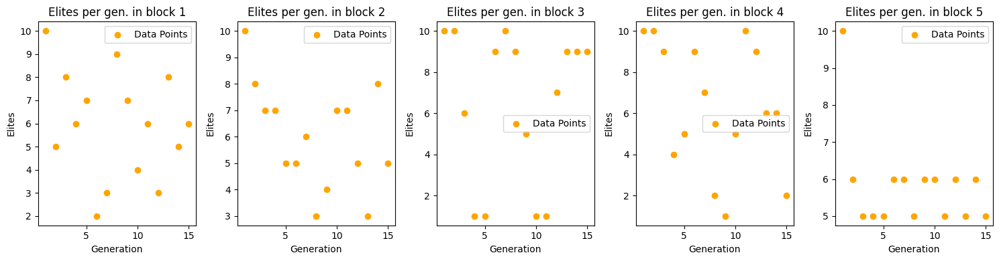

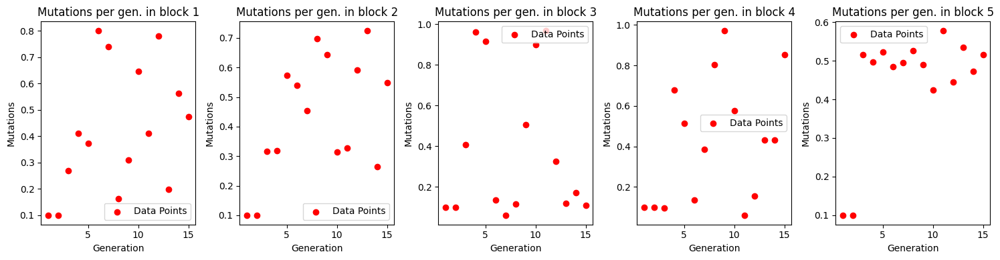

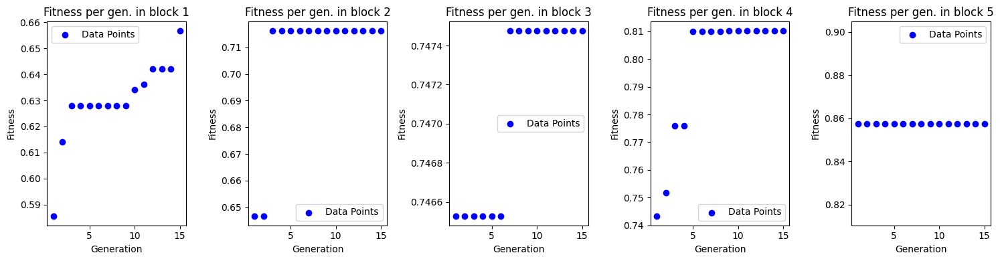

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

def generate_plot(curr_list, block_count, y_label='Y-axis', x_label='X-axis', title='Example', color='blue'):
  start = 0
  end = int(len(curr_list)/block_count)
  fig, axes = plt.subplots(1, block_count, figsize=(15, 4))

  x = []
  for j in range(1, int(len(curr_list)/block_count) + 1):
      x.append(j)

  for i, ax in enumerate(axes):
      y = curr_list[start:end]
      ax.scatter(x, y, label=f'Data Points', color=color, marker='o')
      ax.set_title(f'{title} {i + 1}')
      ax.set_xlabel(x_label)
      ax.set_ylabel(y_label)
      ax.legend()
      start = start + int(len(curr_list)/block_count)
      end = end + int(len(curr_list)/block_count)

  plt.tight_layout()
  plt.show()


generate_plot(result_obj.elite_list, 5, 'Elites', 'Generation', 'Elites per gen. in block', color='orange')
generate_plot(result_obj.mutation_list, 5, 'Mutations', 'Generation', 'Mutations per gen. in block', color='red')
generate_plot(result_obj.fitness_list, 5, 'Fitness', 'Generation', 'Fitness per gen. in block')

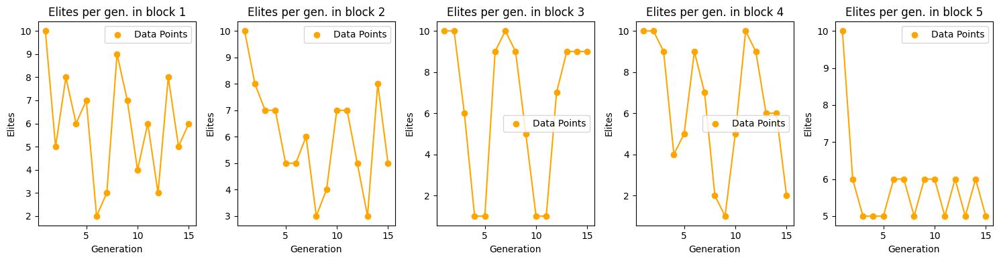

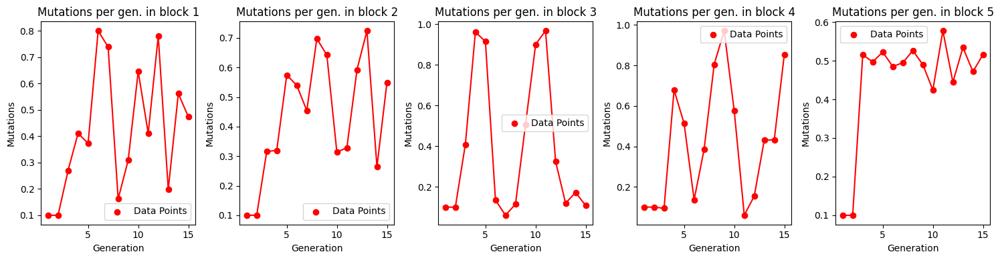

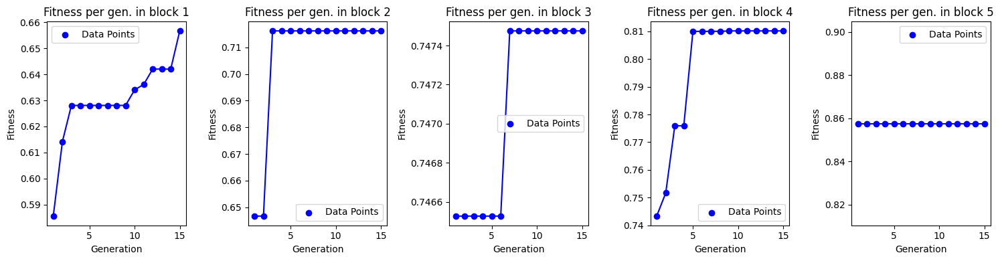

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

def generate_plot(curr_list, block_count, y_label='Y-axis', x_label='X-axis', title='Example', color='blue'):
    start = 0
    end = int(len(curr_list) / block_count)
    fig, axes = plt.subplots(1, block_count, figsize=(15, 4))

    x = []
    for j in range(1, int(len(curr_list) / block_count) + 1):
        x.append(j)

    for i, ax in enumerate(axes):
        y = curr_list[start:end]
        x_vals = np.linspace(min(x), max(x), 1000)
        y_vals = np.interp(x_vals, x, y)

        ax.scatter(x, y, label=f'Data Points', color=color, marker='o')
        ax.plot(x_vals, y_vals, linestyle='-', color=color)
        ax.set_title(f'{title} {i + 1}')
        ax.set_xlabel(x_label)
        ax.set_ylabel(y_label)
        ax.legend()
        start = start + int(len(curr_list) / block_count)
        end = end + int(len(curr_list) / block_count)

    plt.tight_layout()
    plt.show()


# Example usage
generate_plot(result_obj.elite_list, 5, 'Elites', 'Generation', 'Elites per gen. in block', color='orange')
generate_plot(result_obj.mutation_list, 5, 'Mutations', 'Generation', 'Mutations per gen. in block', color='red')
generate_plot(result_obj.fitness_list, 5, 'Fitness', 'Generation', 'Fitness per gen. in block')


In [ ]:
#x = random_search(450)